In [384]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import numpy as np
import plotly
import plotly.graph_objects as go
from plotly.subplots import make_subplots

Below is population data by sex and single year of age for July 1, 2019. It is calld 'Single Year of Age and Sex Population Estimates: April 1, 2010 to July 1, 2019 - CIVILIAN (SC-EST2019-AGESEX-CIV)'. This will be used to merge with the COVID death data to calculate death rates.

In [385]:
pop = pd.read_csv('https://www2.census.gov/programs-surveys/popest/tables/2010-2019/state/asrh/sc-est2019-agesex-civ.csv')
pop = pop[pop.SEX == 0]
pop = pop[['NAME','AGE','POPEST2019_CIV']]
pop.columns = ['NAME','AGE','Population']
pop['AgeGroup'] = pd.cut(pop['AGE'], bins = [-1, 24, 34, 44, 54, 64, 74, 84, 85, 9999],
       labels = ['0-24','25-34','35-44','45-54','55-64','65-74','75-84','85+','All Ages'])
population = pop.groupby(['NAME','AgeGroup'])['Population'].sum().reset_index()

In [386]:
Biggest = population[population.AgeGroup == 'All Ages'].sort_values('Population', ascending = False)['NAME']
def get_biggest_states(number = 10):
    number = number + 1
    return Biggest[:number]

In [387]:
center = pd.read_csv("https://www2.census.gov/geo/docs/reference/cenpop2010/CenPop2010_Mean_ST.txt")
also = pd.read_csv("https://www2.census.gov/geo/docs/reference/cenpop2010/CenPop2010_Mean_US.txt")
also['STNAME'] = 'United States'
center = center.append(also)
center = center[['STNAME','LATITUDE','LONGITUDE']]
center

,STNAME,LATITUDE,LONGITUDE
0,Alabama,33.008097,-86.756826
1,Alaska,61.399882,-148.873973
2,Arizona,33.368266,-111.864310
3,Arkansas,35.142580,-92.655243
4,California,35.463595,-119.325359
5,Colorado,39.513420,-105.208056
6,Connecticut,41.497001,-72.870342
7,Delaware,39.358946,-75.556835
8,District of Columbia,38.910270,-77.014468
9,Florida,27.822726,-81.634654


# 1 Data 

This is the 'Conditions Contributing to COVID-19 Deaths, by State and Age' dataset from NCHS. This is the updated on June 2, 2021 edition. This dataset shows health conditions and contributing causes mentioned in conjunction with deaths involving coronavirus disease 2019 (COVID-19) by age group and jurisdiction of occurrence. 

Footnote from website:

Number of conditions reported in this table are tabulated from deaths received and coded as of the date of analysis and do not represent all deaths that occurred in that period. Data during this period are incomplete because of the lag in time between when the death occurred and when the death certificate is completed, submitted to NCHS and processed for reporting purposes. This delay can range from 1 week to 8 weeks or more. Conditions contributing to the death were identified using the International Classification of Diseases, Tenth Revision (ICD-10). Deaths involving more than one condition (e.g., deaths involving both diabetes and respiratory arrest) were counted in both totals. To avoid counting the same death multiple times, the numbers for different conditions should not be summated. Deaths with confirmed or presumed COVID-19, coded to ICD–10 code U07.1. “COVID-19 Deaths” represents the number of deaths that mention one or more of the conditions indicated. The “Number of Mentions” column represents the number of total conditions mentioned for each age group.

In [388]:
df = pd.read_csv('Conditions_Contributing_to_COVID-19_Deaths__by_State_and_Age.csv')

In [389]:
df.shape

(248400, 14)

In [390]:
df.head()

,Data As Of,Start Date,End Date,Group,Year,Month,State,Condition Group,Condition,ICD10_codes,Age Group,COVID-19 Deaths,Number of Mentions,Flag
0,05/30/2021,01/01/2020,05/29/2021,By Total,NaN,NaN,United States,Respiratory diseases,Influenza and pneumonia,J09-J18,0-24,409.0,426.0,NaN
1,05/30/2021,01/01/2020,05/29/2021,By Total,NaN,NaN,United States,Respiratory diseases,Influenza and pneumonia,J09-J18,25-34,1865.0,1911.0,NaN
2,05/30/2021,01/01/2020,05/29/2021,By Total,NaN,NaN,United States,Respiratory diseases,Influenza and pneumonia,J09-J18,35-44,4961.0,5090.0,NaN
3,05/30/2021,01/01/2020,05/29/2021,By Total,NaN,NaN,United States,Respiratory diseases,Influenza and pneumonia,J09-J18,45-54,14705.0,15124.0,NaN
4,05/30/2021,01/01/2020,05/29/2021,By Total,NaN,NaN,United States,Respiratory diseases,Influenza and pneumonia,J09-J18,55-64,37388.0,38398.0,NaN


In [391]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 248400 entries, 0 to 248399
Data columns (total 14 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   Data As Of          248400 non-null  object 
 1   Start Date          248400 non-null  object 
 2   End Date            248400 non-null  object 
 3   Group               248400 non-null  object 
 4   Year                235980 non-null  float64
 5   Month               211140 non-null  float64
 6   State               248400 non-null  object 
 7   Condition Group     248400 non-null  object 
 8   Condition           248400 non-null  object 
 9   ICD10_codes         248400 non-null  object 
 10  Age Group           248400 non-null  object 
 11  COVID-19 Deaths     183722 non-null  float64
 12  Number of Mentions  185590 non-null  float64
 13  Flag                64678 non-null   object 
dtypes: float64(4), object(10)
memory usage: 26.5+ MB


In [392]:
df.describe()

,Year,Month,COVID-19 Deaths,Number of Mentions
count,235980.000000,211140.000000,183722.000000,185590.000000
mean,2020.315789,5.470588,142.274828,151.303179
std,0.464831,3.397544,2556.148244,2705.100248
min,2020.000000,1.000000,0.000000,0.000000
25%,2020.000000,3.000000,0.000000,0.000000
50%,2020.000000,5.000000,0.000000,0.000000
75%,2021.000000,8.000000,22.000000,24.000000
max,2021.000000,12.000000,581832.000000,581832.000000


The `Condition Group` variable completely overlaps with the `Condition` variable. It is possible to create the `Condition Group` variable from the `Condition` variable alone as seen by function condition_to_group below. The `Condition` variable simply creates more categories for respiratory diseases and circulatory diseases.

The `ICD10_codes` variable has a one-to-one relationship with `Condition`, so the two variables are actually interchangable.

In [393]:
def condition_to_group(condition):
    condition = condition.replace(['Influenza and pneumonia','Chronic lower respiratory diseases','Adult respiratory distress syndrome',
                       'Respiratory failure','Respiratory arrest','Other diseases of the respiratory system'],'Respiratory diseases')
    condition = condition.replace(['Hypertensive diseases','Ischemic heart disease','Cardiac arrest','Cardiac arrhythmia',
                                  'Heart failure','Cerebrovascular diseases','Other diseases of the circulatory system'],'Circulatory diseases')
    return condition
def condition_to_ICD10(condition):
    codes = ['J09-J18','J40-J47','J80','J96','R09.2','J00-J06, J20-J39, J60-J70, J81-J86, J90-J95, J97-J99, U04',
            'I10-I15','I20-I25','I46','I44, I45, I47-I49','I50','I60-I69',
            'I00-I09, I26-I43, I51, I52, I70-I99','A40-A41','C00-C97','E10-E14','E65-E68','G30',
             'F01, F03','N17-N19',
             'S00-T98, V01-X59, X60-X84, X85-Y09, Y10-Y36, Y40-Y89, U01-U03',
             'A00-A39, A42-B99, D00-E07, E15-E64, E70-E90, F00, F02, F04-G26, G31-H95, K00-K93, L00-M99, N00-N16, N20-N98, O00-O99, P00-P96, Q00-Q99, R00-R08, R09.0, R09.1, R09.3, R09.8, R10-R99',
            'U071']
    conditions = ['Influenza and pneumonia','Chronic lower respiratory diseases',
                  'Adult respiratory distress syndrome','Respiratory failure','Respiratory arrest',
                'Other diseases of the respiratory system','Hypertensive diseases','Ischemic heart disease',
                'Cardiac arrest','Cardiac arrhythmia','Heart failure','Cerebrovascular diseases',
                'Other diseases of the circulatory system','Sepsis','Malignant neoplasms','Diabetes',
                  'Obesity','Alzheimer disease','Vascular and unspecified dementia',
                  'Renal failure',
                  'Intentional and unintentional injury, poisoning, and other adverse events',
                  'All other conditions and causes (residual)','COVID-19']
    condition = condition.replace(conditions, codes)
    return condition

Below is creating a new DataFrame, where all the deaths and mentions from January 1, 2020 through April 30, 2021 is combined. This is done because the death data total that includes May 2021 is still provisional and the death data for that month is mostly incomplete. Therefore, May 2021 needs to be excluded from the DataFrame. Afterwards, the DataFrame is merged with the population data. Then the death rate can be calculated.

Also, immediately remove New York City, which is a subset of New York. Remove Puerto Rico as it is not a state and not of interest here.

In [394]:
df = df[(df.State != 'Puerto Rico') & (df.State != 'New York City')]
filt = df[(df['Start Date'] != '05/01/2021') & (df['Group'] == 'By Month')]
by_may1 = filt.groupby(['State','Age Group','Condition'])[['COVID-19 Deaths','Number of Mentions']].sum().reset_index()                                                
by_may1['Condition Group'] = condition_to_group(by_may1['Condition'])
by_may1 = by_may1.merge(population, how='left', left_on=['State','Age Group'], right_on=['NAME','AgeGroup'])
by_may1 = by_may1.drop(['NAME','AgeGroup'], axis = 1)
by_may1['Death Rate'] = by_may1['COVID-19 Deaths']/by_may1['Population']*100
by_may1['Mention Rate'] = by_may1['Number of Mentions']/by_may1['Population']*100

Drop the `Flag` for being not useful for analysis. All it does is a footnote whether data is suppressed if there isn't enough data. `Data As Of` is not useful it is all just equal to 05/30/2021. `Start Date`, `End Date`, and `ICD10_codes` are extraneous information that can be found in other columns.

In [395]:
df = df.merge(population, how = 'left', left_on=['State','Age Group'], right_on = ['NAME','AgeGroup'])
df = df.drop(['NAME','AgeGroup'], axis = 1)
df['Death Rate'] = df['COVID-19 Deaths']/df['Population']*100
df['Mention Rate'] = df['Number of Mentions']/df['Population']*100
df = df[(df['Start Date'] != '05/01/2021')]
df = df.drop(['Flag','Data As Of','Start Date','End Date','ICD10_codes'], axis = 1)

In [396]:
df

,Group,Year,Month,State,Condition Group,Condition,Age Group,COVID-19 Deaths,Number of Mentions,Population,Death Rate,Mention Rate
0,By Total,NaN,NaN,United States,Respiratory diseases,Influenza and pneumonia,0-24,409.0,426.0,102821051.0,0.000398,0.000414
1,By Total,NaN,NaN,United States,Respiratory diseases,Influenza and pneumonia,25-34,1865.0,1911.0,45482275.0,0.004100,0.004202
2,By Total,NaN,NaN,United States,Respiratory diseases,Influenza and pneumonia,35-44,4961.0,5090.0,41430182.0,0.011974,0.012286
3,By Total,NaN,NaN,United States,Respiratory diseases,Influenza and pneumonia,45-54,14705.0,15124.0,40816619.0,0.036027,0.037054
4,By Total,NaN,NaN,United States,Respiratory diseases,Influenza and pneumonia,55-64,37388.0,38398.0,42444212.0,0.088087,0.090467
...,...,...,...,...,...,...,...,...,...,...,...,...
239194,By Month,2020.0,12.0,Wyoming,COVID-19,COVID-19,All Ages,183.0,183.0,575665.0,0.031789,0.031789
239195,By Month,2021.0,1.0,Wyoming,COVID-19,COVID-19,All Ages,99.0,99.0,575665.0,0.017198,0.017198
239196,By Month,2021.0,2.0,Wyoming,COVID-19,COVID-19,All Ages,45.0,45.0,575665.0,0.007817,0.007817
239197,By Month,2021.0,3.0,Wyoming,COVID-19,COVID-19,All Ages,17.0,17.0,575665.0,0.002953,0.002953


##### ICD10_codes meaning: 
- Encounter for screening for COVID-19 (Z11.52)
- Contact with and (suspected) exposure to COVID-19 (Z20.822)
- Personal history of COVID-19 (Z86.16)
- Multisystem inflammatory syndrome (MIS) (M35.81)
- Other specified systemic involvement of connective tissue (M35.89)
- Pneumonia due to coronavirus disease 2019 (J12.82)

Reference: https://www.cdc.gov/nchs/icd/icd10.htm

### EDA(incomplete)

In [460]:
def get_percent_of_deathsage(frame, inde = ['State','Year','Month','Condition'], col = 'Age Group', val = 'COVID-19 Deaths'):
    piv = frame.pivot(index = inde, columns = col, values = val)
    pov = piv.copy()
    keep = piv.columns
    for col in keep:
        pov[col] = piv[col]/piv['All Ages']
    return pd.melt(pov.reset_index(), value_vars=keep, id_vars=inde)
# Gets percent of deaths with certain condition. Note that if 0 COVID-19 deaths, then a NaN results since divide by 0 error
def get_percent_of_deaths(frame, inde = ['State','Year','Month','Age Group'], col = 'Condition', val = 'Death Rate'):
    piv = frame.pivot(index = inde, columns = col, values = val)
    pov = piv.copy()
    keep = piv.columns
    for col in keep:
        pov[col] = piv[col]/piv['COVID-19']
    return pd.melt(pov.reset_index(), value_vars=keep, id_vars=inde)
# Converts the Year/Month into a single Year/Month using ISO format
def yearmonth(frame):
    frame['Year/Month'] = frame['Year'].astype(int).astype(str) + "/" + frame['Month'].astype(int).astype(str).str.zfill(2)
    return frame
# Cutyearmonth cuts by month: Note that 1 is 2020/1, 12 is 2020/12, and 16 is 2021/4
# This function allows grouping months. 
def cutyearmonth(frame, cuts = [0,9,17], names = ['First','Second']):
    frame['Peak'] = (frame['Year'].astype(int)-2020)*12 + frame['Month'].astype(int)
    frame['Peak'] = pd.cut(frame['Peak'], bins = cuts, labels = names)
    return frame
explore = df.query('Group == "By Month"')
explore = yearmonth(explore)
explore = cutyearmonth(explore)
explore = explore.merge(center, how='left', left_on=['State'], right_on=['STNAME'])
explore = explore.drop(['STNAME'], axis = 1)

<ipython-input-460-a4a636352767>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame['Year/Month'] = frame['Year'].astype(int).astype(str) + "/" + frame['Month'].astype(int).astype(str).str.zfill(2)
<ipython-input-460-a4a636352767>:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame['Peak'] = (frame['Year'].astype(int)-2020)*12 + frame['Month'].astype(int)
<ipython-input-460-a4a636352767>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[r

In [398]:
import seaborn as sns
import matplotlib.dates

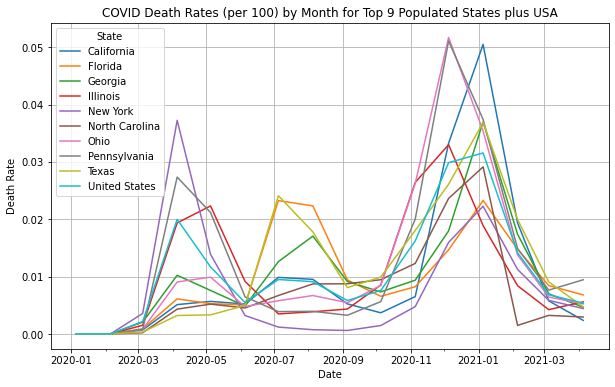

In [399]:
temp = explore.groupby(['Year/Month','State','Condition','Age Group'])[['Death Rate','Mention Rate']].sum().reset_index()
temp = temp.merge(center, how='left', left_on=['State'], right_on=['STNAME']).drop(['STNAME'], axis = 1)
allages = temp[(temp.Condition == 'COVID-19') & (temp['Age Group'] == 'All Ages')]
allages = allages[allages.State.isin(get_biggest_states(9))]
fig, ax = plt.subplots(figsize = (10,6))
allages['Date'] = matplotlib.dates.datestr2num(allages['Year/Month'])
ax.xaxis.set_major_formatter(matplotlib.dates.DateFormatter('%Y-%m'))
fmt_year = matplotlib.dates.MonthLocator(interval=2)
ax.xaxis.set_major_locator(fmt_year)
fmt_month = matplotlib.dates.MonthLocator()
ax.xaxis.set_minor_locator(fmt_month)
ax.set_title("COVID Death Rates (per 100) by Month for Top 9 Populated States plus USA")
plt.grid()
plot = sns.lineplot(data=allages, x="Date",y="Death Rate",hue="State",ax=ax)
plt.savefig("DeathRateTop10.png", dpi = 300)

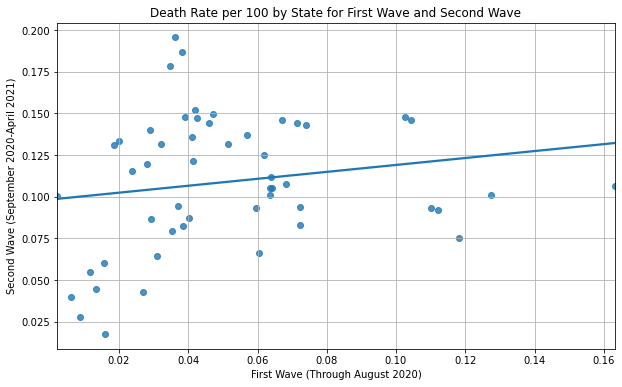

In [403]:
temp2 = explore.groupby(['Peak','State','Condition','Age Group'])[['Death Rate','Mention Rate']].sum().reset_index()
temp2.merge(center, how='left', left_on=['State'], right_on=['STNAME']).drop(['STNAME'], axis = 1)
period = temp2[(temp2.Condition == 'COVID-19') & (temp2['Age Group'] == 'All Ages')]
period = period.pivot(index = 'State', columns = 'Peak', values = 'Death Rate')
fig, ax = plt.subplots(figsize = (10,6))
plot = sns.regplot(data=period, x="First",y="Second", ax=ax, ci = None)
ax.set_xlabel("First Wave (Through August 2020)")
ax.set_ylabel("Second Wave (September 2020-April 2021)")
plt.grid()
ax.set_title("Death Rate per 100 by State for First Wave and Second Wave")
plt.savefig("FirstSecondWave.png", dpi = 300)

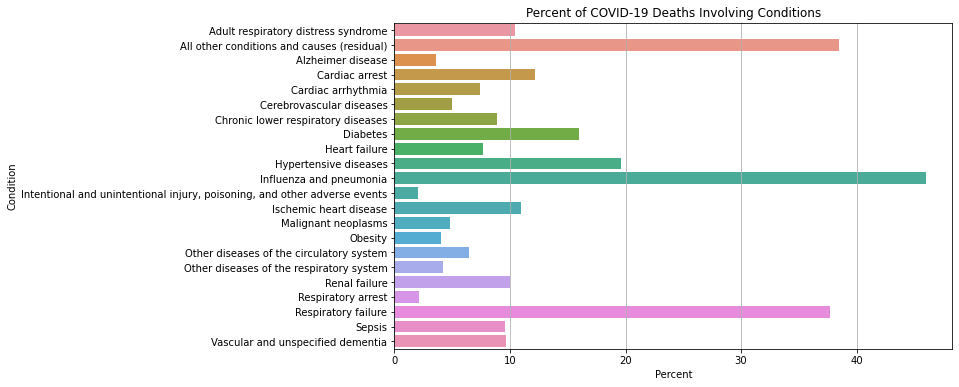

In [408]:
totald = df.query('Group == "By Total"')
totald = get_percent_of_deaths(totald)
totald['value'] = totald['value']*100
temp2 = totald[(totald['Age Group'] == 'All Ages') & (totald['State'] == 'United States') & (totald['Condition'] != 'COVID-19')]
fig, ax = plt.subplots(figsize = (10,6))
sns.barplot(data=temp2, y="Condition",x="value",ax=ax)
plt.grid(axis='x')
ax.set_xlabel('Percent')
ax.set_title('Percent of COVID-19 Deaths Involving Conditions')
plt.savefig('PercentConditions.png', dpi = 300)

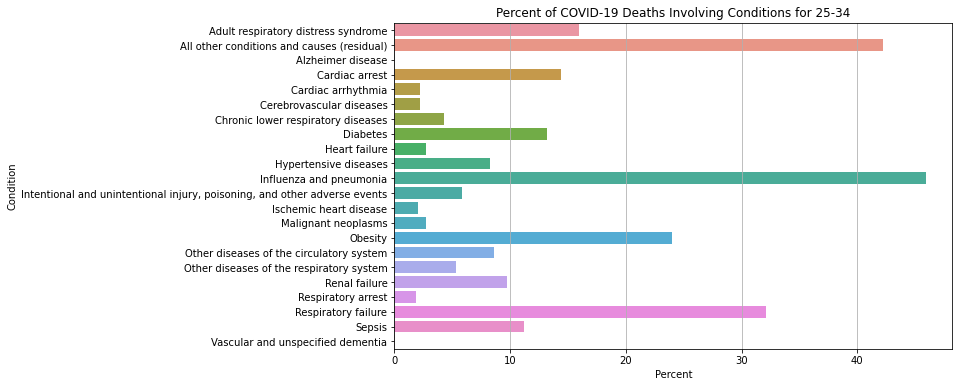

In [409]:
totald = df.query('Group == "By Total"')
totald = get_percent_of_deaths(totald)
totald['value'] = totald['value']*100
temp2 = totald[(totald['Age Group'] == '25-34') & (totald['State'] == 'United States') & (totald['Condition'] != 'COVID-19')]
fig, ax = plt.subplots(figsize = (10,6))
sns.barplot(data=temp2, y="Condition",x="value",ax=ax)
plt.grid(axis='x')
ax.set_xlabel('Percent')
ax.set_title('Percent of COVID-19 Deaths Involving Conditions for 25-34')
plt.savefig('PercentConditions25-34.png', dpi = 300)

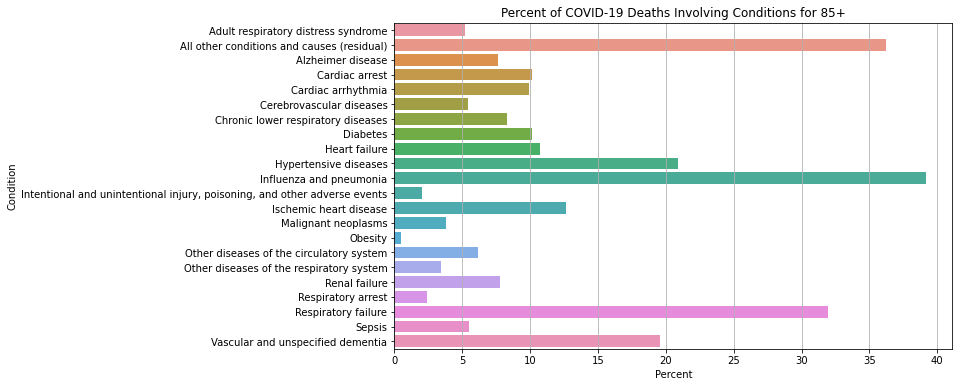

In [410]:
totald = df.query('Group == "By Total"')
totald = get_percent_of_deaths(totald)
totald['value'] = totald['value']*100
temp2 = totald[(totald['Age Group'] == '85+') & (totald['State'] == 'United States') & (totald['Condition'] != 'COVID-19')]
fig, ax = plt.subplots(figsize = (10,6))
sns.barplot(data=temp2, y="Condition",x="value",ax=ax)
plt.grid(axis='x')
ax.set_xlabel('Percent')
ax.set_title('Percent of COVID-19 Deaths Involving Conditions for 25-34')
plt.savefig('PercentConditions85+.png', dpi = 300)

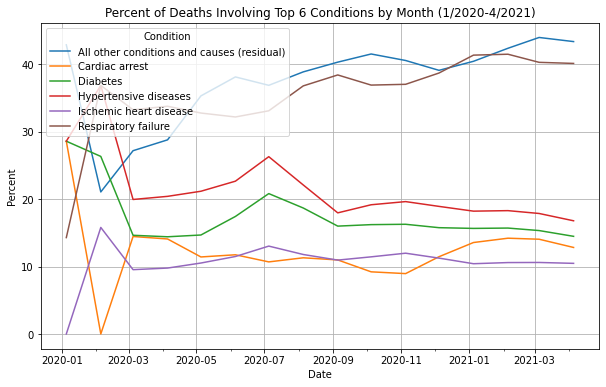

In [452]:
totald = df.query('Group == "By Month"')
totald = totald.query('State == "United States"')
totald = get_percent_of_deaths(totald)
totald = totald[(totald['Age Group'] == 'All Ages')]
totald = totald[(totald['Condition'] == 'Influenza and Pnemonia') | (totald['Condition'] == 'Respiratory failure') |
                (totald['Condition'] == 'All other conditions and causes (residual)') | (totald['Condition'] == 'Hypertensive diseases') |
                (totald['Condition'] == 'Diabetes') | (totald['Condition'] == 'Ischemic heart disease') | (totald['Condition'] == 'Cardiac arrest')]
totald = yearmonth(totald)
totald['value'] = totald['value']*100
fig, ax = plt.subplots(figsize = (10,6))
totald['Date'] = matplotlib.dates.datestr2num(totald['Year/Month'])
ax.xaxis.set_major_formatter(matplotlib.dates.DateFormatter('%Y-%m'))
fmt_year = matplotlib.dates.MonthLocator(interval=2)
ax.xaxis.set_major_locator(fmt_year)
fmt_month = matplotlib.dates.MonthLocator()
ax.xaxis.set_minor_locator(fmt_month)
ax.set_title("Percent of Deaths Involving Top 6 Conditions by Month (1/2020-4/2021)")
plt.grid()
plot = sns.lineplot(data=totald, x="Date",y="value",hue="Condition",ax=ax)
ax.set_ylabel('Percent')
plt.savefig("ConditionsByMonth.png", dpi = 300)

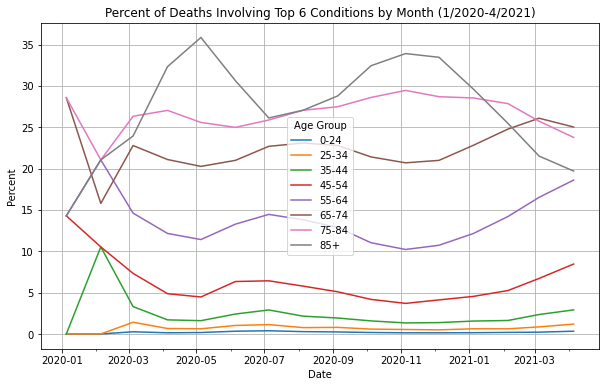

In [463]:
totald = df.query('Group == "By Month"')
totald = totald.query('State == "United States"')
totald = get_percent_of_deathsage(totald)
totald = totald[(totald['Condition'] == 'COVID-19') & (totald['Age Group'] != 'Not stated') & (totald['Age Group'] != 'All Ages')]
totald = yearmonth(totald)
totald['value'] = totald['value']*100
fig, ax = plt.subplots(figsize = (10,6))
totald['Date'] = matplotlib.dates.datestr2num(totald['Year/Month'])
ax.xaxis.set_major_formatter(matplotlib.dates.DateFormatter('%Y-%m'))
fmt_year = matplotlib.dates.MonthLocator(interval=2)
ax.xaxis.set_major_locator(fmt_year)
fmt_month = matplotlib.dates.MonthLocator()
ax.xaxis.set_minor_locator(fmt_month)
ax.set_title("Percent of Deaths Involving Top 6 Conditions by Month (1/2020-4/2021)")
plt.grid()
plot = sns.lineplot(data=totald, x="Date",y="value",hue="Age Group",ax=ax)
ax.set_ylabel('Percent')
plt.savefig("AgeGroupByMonth.png", dpi = 300)

### Data Preprocessing

In [28]:
df_som = df_use[['State', 'ICD10_codes', 'Age Group','COVID-19 Deaths', 'Number of Mentions', 'Condition', 'Condition Group']]

In [157]:
df_som

,State,ICD10_codes,Age Group,COVID-19 Deaths,Number of Mentions,Condition,Condition Group,state_encode,cond_group_encode,ICD10_encode,condition_encode,Age_labeled
0,United States,J09-J18,0-24,409.0,426.0,Influenza and pneumonia,Respiratory diseases,0.025038,0.259544,0.044959,0.044959,0
1,United States,J09-J18,25-34,1865.0,1911.0,Influenza and pneumonia,Respiratory diseases,0.025038,0.259544,0.044959,0.044959,1
2,United States,J09-J18,35-44,4961.0,5090.0,Influenza and pneumonia,Respiratory diseases,0.025038,0.259544,0.044959,0.044959,2
3,United States,J09-J18,45-54,14705.0,15124.0,Influenza and pneumonia,Respiratory diseases,0.025038,0.259544,0.044959,0.044959,3
4,United States,J09-J18,55-64,37388.0,38398.0,Influenza and pneumonia,Respiratory diseases,0.025038,0.259544,0.044959,0.044959,4
...,...,...,...,...,...,...,...,...,...,...,...,...
248395,Puerto Rico,U071,All Ages,246.0,246.0,COVID-19,COVID-19,0.017037,0.046728,0.046728,0.046728,8
248396,Puerto Rico,U071,All Ages,131.0,131.0,COVID-19,COVID-19,0.017037,0.046728,0.046728,0.046728,8
248397,Puerto Rico,U071,All Ages,67.0,67.0,COVID-19,COVID-19,0.017037,0.046728,0.046728,0.046728,8
248398,Puerto Rico,U071,All Ages,184.0,184.0,COVID-19,COVID-19,0.017037,0.046728,0.046728,0.046728,8


In [29]:
df_som.head()

,State,ICD10_codes,Age Group,COVID-19 Deaths,Number of Mentions,Condition,Condition Group
0,United States,J09-J18,0-24,409.0,426.0,Influenza and pneumonia,Respiratory diseases
1,United States,J09-J18,25-34,1865.0,1911.0,Influenza and pneumonia,Respiratory diseases
2,United States,J09-J18,35-44,4961.0,5090.0,Influenza and pneumonia,Respiratory diseases
3,United States,J09-J18,45-54,14705.0,15124.0,Influenza and pneumonia,Respiratory diseases
4,United States,J09-J18,55-64,37388.0,38398.0,Influenza and pneumonia,Respiratory diseases


In [30]:
df_som.nunique()

State                   54
ICD10_codes             23
Age Group               10
COVID-19 Deaths       3329
Number of Mentions    3472
Condition               23
Condition Group         12
dtype: int64

##### Frequency Encoding 
- replace each of the categories with its count or frequency
- value with the same counts will be encoded with the same number
- the output is the normalized counts 

In [31]:
# frequency encoding on state
enc_nom_1 = (df_som.groupby('State').size()) / len(df_som['State'])
df_som['state_encode'] = df_som['State'].apply(lambda x : enc_nom_1[x])

<ipython-input-31-e5a69d7f061d>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_som['state_encode'] = df_som['State'].apply(lambda x : enc_nom_1[x])


In [32]:
enc_nom_1

State
Alabama                 0.017646
Alaska                  0.019633
Arizona                 0.017951
Arkansas                0.018044
California              0.020248
Colorado                0.017586
Connecticut             0.018441
Delaware                0.019051
District of Columbia    0.018321
Florida                 0.019965
Georgia                 0.018773
Hawaii                  0.019116
Idaho                   0.018060
Illinois                0.018806
Indiana                 0.018490
Iowa                    0.017869
Kansas                  0.017439
Kentucky                0.018784
Louisiana               0.018005
Maine                   0.019328
Maryland                0.018348
Massachusetts           0.018136
Michigan                0.018523
Minnesota               0.018174
Mississippi             0.017880
Missouri                0.018261
Montana                 0.018539
Nebraska                0.017358
Nevada                  0.017423
New Hampshire           0.018969
New 

In [26]:
# df_som.drop(['State'], axis = 1, inplace = True)

In [43]:
df_som['Condition Group'].value_counts()

Circulatory diseases                                                         56486
Respiratory diseases                                                         48410
Vascular and unspecified dementia                                             9150
Alzheimer disease                                                             9068
COVID-19                                                                      8581
All other conditions and causes (residual)                                    8152
Diabetes                                                                      8049
Renal failure                                                                 7928
Sepsis                                                                        7880
Malignant neoplasms                                                           7877
Intentional and unintentional injury, poisoning, and other adverse events     7558
Obesity                                                                       7322
Name

In [34]:
# frequency encoding on condition group 
enc_nom_2 = (df_som.groupby('Condition Group').size()) / len(df_som['Condition Group'])
df_som['cond_group_encode'] = df_som['Condition Group'].apply(lambda x : enc_nom_2[x])

<ipython-input-34-910e7dadf183>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_som['cond_group_encode'] = df_som['Condition Group'].apply(lambda x : enc_nom_2[x])


In [35]:
enc_nom_2

Condition Group
All other conditions and causes (residual)                                   0.044105
Alzheimer disease                                                            0.048829
COVID-19                                                                     0.046728
Circulatory diseases                                                         0.302403
Diabetes                                                                     0.043087
Intentional and unintentional injury, poisoning, and other adverse events    0.040354
Malignant neoplasms                                                          0.042080
Obesity                                                                      0.038879
Renal failure                                                                0.042445
Respiratory diseases                                                         0.259544
Sepsis                                                                       0.042162
Vascular and unspecified dementia     

In [45]:
# frequency encoding on ICD10_codes
enc_nom_3 = (df_som.groupby('ICD10_codes').size()) / len(df_som['ICD10_codes'])
df_som['ICD10_encode'] = df_som['ICD10_codes'].apply(lambda x : enc_nom_3[x])

In [46]:
enc_nom_3

ICD10_codes
A00-A39, A42-B99, D00-E07, E15-E64, E70-E90, F00, F02, F04-G26, G31-H95, K00-K93, L00-M99, N00-N16, N20-N98, O00-O99, P00-P96, Q00-Q99, R00-R08, R09.0, R09.1, R09.3, R09.8, R10-R99    0.044105
A40-A41                                                                                                                                                                                 0.042162
C00-C97                                                                                                                                                                                 0.042080
E10-E14                                                                                                                                                                                 0.043087
E65-E68                                                                                                                                                                                 0.038879
F01, F03               

In [47]:
# frequency encoding on death conditions
enc_nom_4 = (df_som.groupby('Condition').size()) / len(df_som['Condition'])
df_som['condition_encode'] = df_som['Condition'].apply(lambda x : enc_nom_4[x])

In [48]:
enc_nom_4

Condition
Adult respiratory distress syndrome                                          0.041225
All other conditions and causes (residual)                                   0.044105
Alzheimer disease                                                            0.048829
COVID-19                                                                     0.046728
Cardiac arrest                                                               0.042129
Cardiac arrhythmia                                                           0.044007
Cerebrovascular diseases                                                     0.042885
Chronic lower respiratory diseases                                           0.043571
Diabetes                                                                     0.043087
Heart failure                                                                0.043794
Hypertensive diseases                                                        0.044377
Influenza and pneumonia                     

##### Label Encoding

In [49]:
# label encoding on age group 
from sklearn import preprocessing
le = preprocessing.LabelEncoder()
df_som['Age_labeled'] = le.fit_transform(df_som[['Age Group']])

C:\Users\williamshih\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)


In [50]:
df_som.head()

,State,ICD10_codes,Age Group,COVID-19 Deaths,Number of Mentions,Condition,Condition Group,state_encode,cond_group_encode,ICD10_encode,condition_encode,Age_labeled
0,United States,J09-J18,0-24,409.0,426.0,Influenza and pneumonia,Respiratory diseases,0.025038,0.259544,0.044959,0.044959,0
1,United States,J09-J18,25-34,1865.0,1911.0,Influenza and pneumonia,Respiratory diseases,0.025038,0.259544,0.044959,0.044959,1
2,United States,J09-J18,35-44,4961.0,5090.0,Influenza and pneumonia,Respiratory diseases,0.025038,0.259544,0.044959,0.044959,2
3,United States,J09-J18,45-54,14705.0,15124.0,Influenza and pneumonia,Respiratory diseases,0.025038,0.259544,0.044959,0.044959,3
4,United States,J09-J18,55-64,37388.0,38398.0,Influenza and pneumonia,Respiratory diseases,0.025038,0.259544,0.044959,0.044959,4


In [51]:
df_som_train = df_som[['COVID-19 Deaths', 'Number of Mentions', 'state_encode','cond_group_encode','ICD10_encode', 'Age_labeled']]

In [52]:
df_som_train.head()

,COVID-19 Deaths,Number of Mentions,state_encode,cond_group_encode,ICD10_encode,Age_labeled
0,409.0,426.0,0.025038,0.259544,0.044959,0
1,1865.0,1911.0,0.025038,0.259544,0.044959,1
2,4961.0,5090.0,0.025038,0.259544,0.044959,2
3,14705.0,15124.0,0.025038,0.259544,0.044959,3
4,37388.0,38398.0,0.025038,0.259544,0.044959,4


In [53]:
data = df_som_train[df_som_train.columns].values

##### Normalization

In [54]:
# normalize the data in the range of 0 to 1
from sklearn import preprocessing
df_som_min_max = df_som_train.copy()
mm_scaler = preprocessing.MinMaxScaler()
df_som_min_max[df_som_train.columns] = mm_scaler.fit_transform(data)

In [55]:
df_som_min_max.head()

,COVID-19 Deaths,Number of Mentions,state_encode,cond_group_encode,ICD10_encode,Age_labeled
0,0.000703,0.000732,1.0,0.837364,0.578756,0.000000
1,0.003205,0.003284,1.0,0.837364,0.578756,0.111111
2,0.008527,0.008748,1.0,0.837364,0.578756,0.222222
3,0.025274,0.025994,1.0,0.837364,0.578756,0.333333
4,0.064259,0.065995,1.0,0.837364,0.578756,0.444444


In [56]:
#prepare train data for SOM classification
nom_data = df_som_min_max[df_som_min_max.columns].values

### Clustering on Death Conditions with SOM

- The goal of SOM is to oberseve the clusters of death condition based on the attributes of state, ICD_codes(diease types), age group, number of deaths, and number of mentions. 

- The visualization of SOM will provide us an overview of death conditions distirbution and what death conditions are similar to each other and what are not. 

- Reference: https://github.com/JustGlowing/minisom

#### SOM training (non-normalized data)

In [58]:
df_som_train

,COVID-19 Deaths,Number of Mentions,state_encode,cond_group_encode,ICD10_encode,Age_labeled
0,409.0,426.0,0.025038,0.259544,0.044959,0
1,1865.0,1911.0,0.025038,0.259544,0.044959,1
2,4961.0,5090.0,0.025038,0.259544,0.044959,2
3,14705.0,15124.0,0.025038,0.259544,0.044959,3
4,37388.0,38398.0,0.025038,0.259544,0.044959,4
...,...,...,...,...,...,...
248395,246.0,246.0,0.017037,0.046728,0.046728,8
248396,131.0,131.0,0.017037,0.046728,0.046728,8
248397,67.0,67.0,0.017037,0.046728,0.046728,8
248398,184.0,184.0,0.017037,0.046728,0.046728,8


In [104]:
# initialization and training of 15x15 SOM
from minisom import MiniSom

som = MiniSom(15, 15, data.shape[1], sigma=1.5, learning_rate=.7, activation_distance='euclidean',
              topology='hexagonal', neighborhood_function='gaussian', random_seed=10)

som.train(data, 100, verbose=True)

 [ 100 / 100 ] 100% - 0:00:00 left 
 quantization error: 20.79989334249394


#### SOM visualization on death conditions (non-normalized data)

In [66]:
from matplotlib.patches import RegularPolygon, Ellipse
from matplotlib.patches import RegularPolygon, Ellipse
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import cm, colorbar
from matplotlib.lines import Line2D

from bokeh.colors import RGB
from bokeh.io import curdoc, show, output_notebook
from bokeh.transform import factor_mark, factor_cmap
from bokeh.models import ColumnDataSource, HoverTool
from bokeh.plotting import figure, output_file

# display matplotlib plots in notebook
%matplotlib inline
# display bokeh plot in notebook
output_notebook()

Loading BokehJS ...

In [94]:
# check the number of unique death conditions
targets = df_som['Condition'].values
print(df_som['Condition'].nunique())

23


In [55]:
from matplotlib.lines import Line2D
# generate number of markers as the counts of unique death conditions
markers_all = []
for key in Line2D.markers.keys():
    markers_all.append(key)
markers = markers_all[:23]

from itertools import cycle
cycol = cycle('bgrcmk')
colors = []
for i in range(23):
    colors.append(next(cycol))

In [57]:
# generate markers for death conditions
def generate_label_markers(targets, markers):
    markers_som = []
    rec_set = set()
    i = -1
    for lab in targets: 
        if lab not in rec_set: 
            rec_set.add(lab)
            i += 1
        markers_som.append(markers[i])
    # print(len(markers_som))
    return markers_som

In [58]:
markers_som = generate_label_markers(targets, markers)

In [59]:
colors_som = generate_label_markers(targets, colors)

In [60]:
# generate legend elements containing death conditions
def generate_legend_elements(markers, colors, labels):
    legend_elements = []
    for i in range(len(labels)): 
        hexagon = Line2D([0], [0], marker=markers[i], color=colors[i], label=labels[i],
                   markerfacecolor='w', markersize=14, linestyle='None', markeredgewidth=2)
        legend_elements.append(hexagon)
    return legend_elements

In [95]:
xx, yy = som.get_euclidean_coordinates()
umatrix = som.distance_map()
weights = som.get_weights()

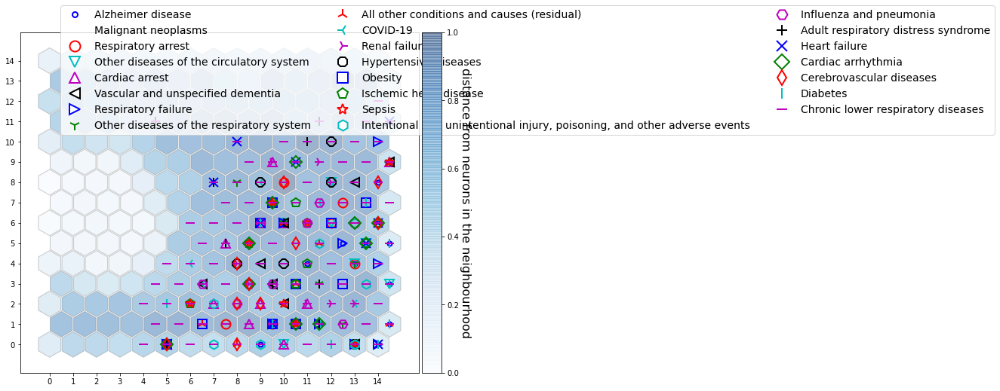

In [105]:
f = plt.figure(figsize=(10,10))
ax = f.add_subplot(111)

ax.set_aspect('equal')

# iteratively add hexagons
for i in range(weights.shape[0]):
    for j in range(weights.shape[1]):
        wy = yy[(i, j)] * np.sqrt(3) / 2
        hex = RegularPolygon((xx[(i, j)], wy), 
                             numVertices=6, 
                             radius=.95 / np.sqrt(3),
                             facecolor=cm.Blues(umatrix[i, j]), 
                             alpha=.4, 
                             edgecolor='gray')
        ax.add_patch(hex)


for cnt, x in enumerate(data):
    # getting the winner
    w = som.winner(x)
    # place a marker on the winning position for the sample xx
    wx, wy = som.convert_map_to_euclidean(w) 
    wy = wy * np.sqrt(3) / 2
    plt.plot(wx, wy, 
             markers_som[cnt], 
             markerfacecolor='None',
             markeredgecolor=colors_som[cnt], 
             markersize=12, 
             markeredgewidth=2)

xrange = np.arange(weights.shape[0])
yrange = np.arange(weights.shape[1])
plt.xticks(xrange-.5, xrange)
plt.yticks(yrange * np.sqrt(3) / 2, yrange)

divider = make_axes_locatable(plt.gca())
ax_cb = divider.new_horizontal(size="5%", pad=0.05)    
cb1 = colorbar.ColorbarBase(ax_cb, cmap=cm.Blues, 
                            orientation='vertical', alpha=.4)
cb1.ax.get_yaxis().labelpad = 16
cb1.ax.set_ylabel('distance from neurons in the neighbourhood',
                  rotation=270, fontsize=16)
plt.gcf().add_axes(ax_cb)

legend_elements = generate_legend_elements(markers, colors, list(set(targets)))
ax.legend(handles=legend_elements, bbox_to_anchor=(0.1, 1.08), loc='upper left', 
          borderaxespad=0., ncol=3, fontsize=14)

plt.savefig('/Users/cookiepoon/STA160_projects/som_death_conditions.png')
plt.show()


- The most widespread death conditions is chronic lower respiratory diseases

###### Overlapping death conditions
- chronic low respiratory disease is the most widespread disease types & overlap with too many varieties of disease types

##### Diseases types that distribute in similar groups
- Cereborvascular diseases & Obesity
- Hypertensive diseases & Vascular and unspecified dementia 


#### Interactive plot (not be able to generate the colors?)

In [68]:
import matplotlib.pyplot as plt
from matplotlib.patches import RegularPolygon, Ellipse
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import cm, colorbar
from matplotlib.lines import Line2D

from bokeh.colors import RGB
from bokeh.io import curdoc, show, output_notebook
from bokeh.transform import factor_mark, factor_cmap
from bokeh.models import ColumnDataSource, HoverTool
from bokeh.plotting import figure, output_file

In [69]:
xx, yy = som.get_euclidean_coordinates()
umatrix = som.distance_map()
weights = som.get_weights()

In [70]:
from itertools import cycle
cycol = cycle('bgrcmk')
colors = []
for i in range(23):
    colors.append(next(cycol))

In [71]:
from matplotlib.lines import Line2D

markers_all = []
for key in Line2D.markers.keys():
    markers_all.append(key)
markers = markers_all[:23]

In [72]:
# label encode death conditions
t_ = df_som["Condition"].astype('category')
t = t_.cat.codes

In [73]:
MARKERS = ['asterisk', 'circle', 'cross', 'square_pin', 'star', 'triangle', 'plus', 'dash', 'diamond', 'dot', 'hex_dot', 'x', 'y', 'star_dot', 'inverted_triangle', 'circle_cross', 'square_dot', 'square_cross', 'triangle_pin', 'triangle_dot', 'square_x', 'circle_y', 'star_dot']
print(len(MARKERS))

23


In [74]:
# import os
# os.getcwd()

In [76]:
# with open('/Users/cookiepoon/STA160_projects/som_conditions.html', 'w'):
    # pass

In [77]:
hex_centre_col, hex_centre_row = [], []
hex_colour = []
label = []

# define labels
CONDITIONS = targets

for i in range(weights.shape[0]):
    for j in range(weights.shape[1]):
        wy = yy[(i, j)] * np.sqrt(3) / 2
        hex_centre_col.append(xx[(i, j)])
        hex_centre_row.append(wy)
        hex_colour.append(cm.Blues(umatrix[i, j]))

weight_x, weight_y = [], []
for cnt, i in enumerate(data):
    w = som.winner(i)
    wx, wy = som.convert_map_to_euclidean(xy=w)
    wy = wy * np.sqrt(3) / 2
    weight_x.append(wx)
    weight_y.append(wy)
    label.append(CONDITIONS[cnt])
    
# convert matplotlib colour palette to bokeh colour palette
hex_plt = [(255 * np.array(i)).astype(int) for i in hex_colour]
hex_bokeh = [RGB(*tuple(rgb)).to_hex() for rgb in hex_plt]

In [78]:
from bokeh.palettes import Viridis256

In [79]:
output_file("/Users/cookiepoon/STA160_projects/som_conditions.html")

# initialise figure/plot
# initialise figure/plot
fig = figure(title="SOM: Hexagonal Topology",
             plot_height=800, plot_width=800,
             match_aspect=True,
             tools="wheel_zoom,save,reset")

# create data stream for plotting
source_hex = ColumnDataSource(
    data = dict(
        x=hex_centre_col,
        y=hex_centre_row,
        c=hex_bokeh
    )
)

source_pages = ColumnDataSource(
    data=dict(
        wx=weight_x,
        wy=weight_y,
        death_conditions=label
    )
)

# define markers
# MARKERS = ['diamond', 'cross', 'x']

# add shapes to plot
fig.hex(x='y', y='x', source=source_hex,
        size=100 * (.95 / np.sqrt(3)),
        alpha=.4,
        line_color='gray',
        fill_color='c')

fig.scatter(x='wy', y='wx', source=source_pages, 
            legend_field='death_conditions',
            size=20, 
            marker=factor_mark(field_name='death_conditions', markers=MARKERS, factors=CONDITIONS),
            color=factor_cmap(field_name='death_conditions', palette=Viridis256[:23], factors=CONDITIONS))

fig.legend.background_fill_alpha = 0.2
# add hover-over tooltip
fig.add_tools(HoverTool(
    tooltips=[
        ("label", '@death_conditions'),
        ("(x,y)", '($x, $y)')],
    mode="mouse", 
    point_policy="follow_mouse"
))

show(fig)

 'Adult respiratory distress syndrome'
 'Adult respiratory distress syndrome' ... 'COVID-19' 'COVID-19'
 'COVID-19'] will be assigned to `nan_color` gray


 'Adult respiratory distress syndrome'
 'Adult respiratory distress syndrome' ... 'COVID-19' 'COVID-19'
 'COVID-19'] will be assigned to `nan_color` gray


From the interactive visualization, death conditions that happend on the same group: 
- influenza and pneumonia & adult respiratoyr distress syndrom

    

#### Most relevant death conditions plane (Normalized data)
- to oberserve death confitions that always happen together
- train som model with normalized data and check death conditions relevancy 

In [106]:
# som with normalized data 
som_nom = MiniSom(15, 15, nom_data.shape[1], sigma=1.5, learning_rate=.7, activation_distance='euclidean',
              topology='hexagonal', neighborhood_function='gaussian', random_seed=10)

som_nom.train(nom_data, 100, verbose=True)

 [ 100 / 100 ] 100% - 0:00:00 left 
 quantization error: 0.518365381750141


In [107]:
feature_names = list(set(targets))

In [101]:
from matplotlib.patches import Patch
def show_relevant_plane(som, size, save_path):
    W = som.get_weights()

    Z = np.zeros((size, size))
    plt.figure(figsize=(8, 8))
    for i in np.arange(som._weights.shape[0]):
        for j in np.arange(som._weights.shape[1]):
            feature = np.argmax(W[i, j , :])
            plt.plot([j+.5], [i+.5], 'o', color='C'+str(feature),
                     marker='s', markersize=24)

    legend_elements = [Patch(facecolor='C'+str(i),
                             edgecolor='w',
                             label=f) for i, f in enumerate(feature_names)]

    plt.legend(handles=legend_elements,
               loc='center left',
               bbox_to_anchor=(1, .95))

    plt.xlim([0, size])
    plt.ylim([0, size])
    plt.savefig(save_path)

    plt.show()


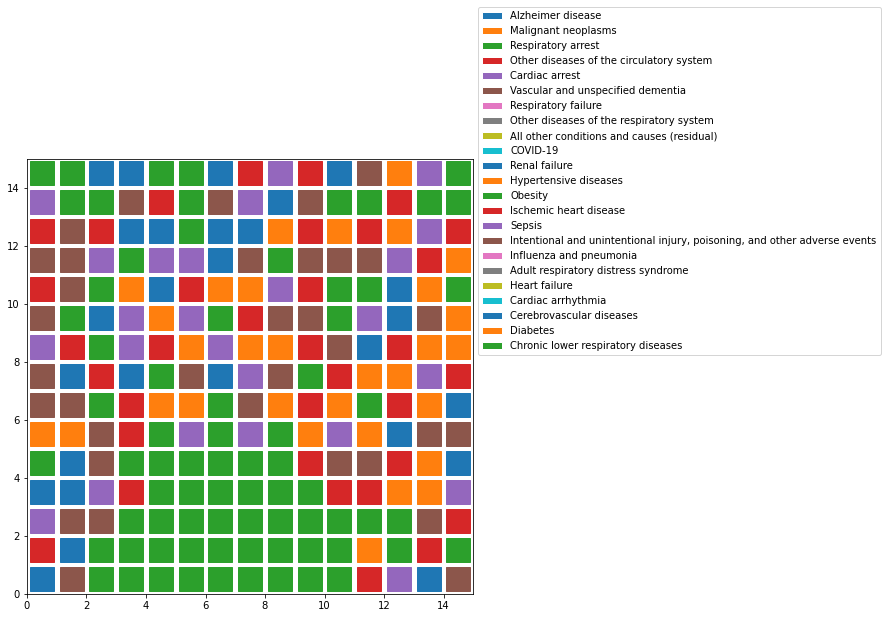

In [108]:
save_path1 = '/Users/cookiepoon/STA160_projects/som_death_conditions_relatedness.png'
show_relevant_plane(som_nom, 15, save_path1)

Based on the most relevant death conditions feature plane: 
- The most widespread death conditions are respiratory arrest, chronic lower respiratory diseases. 
- There's no disinguishing patterns that help us find two most related disease types 

#### Gridspec on disease types

In [111]:
def grid_spec(data, label_names, n_neurons, m_neurons, target, som):
    import matplotlib.gridspec as gridspec

    labels_map = som.labels_map(data, [label_names[t] for t in target])

    fig = plt.figure(figsize=(9, 9))
    the_grid = gridspec.GridSpec(n_neurons, m_neurons, fig)
    for position in labels_map.keys():
        label_fracs = [labels_map[position][l] for l in label_names.values()]
        plt.subplot(the_grid[n_neurons-1-position[1],
                             position[0]], aspect=1)
        patches, texts = plt.pie(label_fracs)

    plt.legend(patches, label_names.values(), bbox_to_anchor=(3.5, 6.5), ncol=3)
    # plt.savefig('/Users/cookiepoon/STA160_projects/som_state_pies.png')
    plt.show()

In [112]:
label_names_condition = {}
conditions = list(set(targets))
for i in range(len(conditions)):
    label_names_condition[i] = conditions[i]

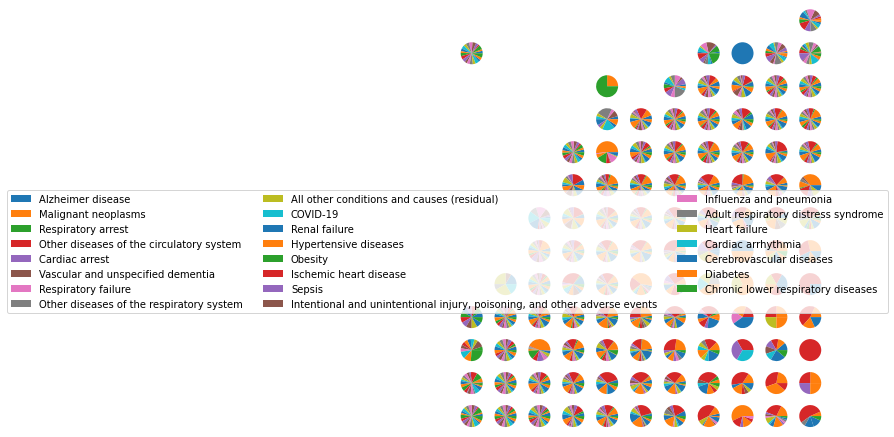

In [113]:
# non-normalized data gridspec
grid_spec(data, label_names_condition, 15, 15, t, som)

For data before normalization, most distributions of death conditions were scattered among different demographics. 

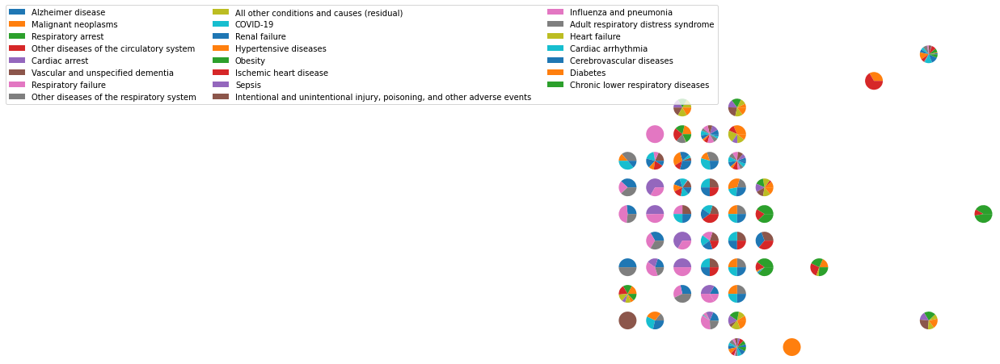

In [114]:
# normalized data gridspec
grid_spec(nom_data, label_names_condition, 15, 15, t, som_nom)

For data after normalization, diseases types that tend to happen together are: 
- Influenza&pneumonia & respiratory failure
- sepsis & cardiac arrest

###  SOM Classification on death conditions

- The classification function classifies a sample in data using label assigned to the associated winning neuron. 
- A label c is associated to a neuron if the majority of samples mapped in that nueron have label c. 
- The function will assign the most common label in the dataset.
- given number of deaths, number of mentions, state, ICD_10 codes, condition group, age group, SOM can classify the type of death conditions based on the most common label in the dataset. 
- This can give us a measurement of the accuracy of death conditions distirbutions from the visualizations.

In [115]:
def classify(som, data):
    """Classifies each sample in data in one of the classes definited
    using the method labels_map.
    Returns a list of the same length of data where the i-th element
    is the class assigned to data[i].
    """
    winmap = som.labels_map(X_train, y_train)
    default_class = np.sum(list(winmap.values())).most_common()[0][0]
    result = []
    for d in data:
        win_position = som.winner(d)
        if win_position in winmap:
            result.append(winmap[win_position].most_common()[0][0])
        else:
            result.append(default_class)
    return result

In [116]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

X_train, X_test, y_train, y_test = train_test_split(nom_data, targets, stratify=targets)

In [117]:
som_class1 = MiniSom(15, 15, data.shape[1], sigma=1.5, learning_rate=.7, activation_distance='euclidean', 
              neighborhood_function='gaussian', random_seed=10)
som_class1.pca_weights_init(X_train)
som_class1.train_random(X_train, 500, verbose=False)

print(classification_report(y_test, classify(som_class1, X_test)))

                                                                           precision    recall  f1-score   support

                                      Adult respiratory distress syndrome       0.44      0.51      0.47      1930
                               All other conditions and causes (residual)       0.52      0.60      0.56      2038
                                                        Alzheimer disease       0.52      0.61      0.56      2267
                                                                 COVID-19       0.93      0.97      0.95      2145
                                                           Cardiac arrest       0.69      0.68      0.69      1969
                                                       Cardiac arrhythmia       0.22      0.15      0.18      2052
                                                 Cerebrovascular diseases       0.59      0.51      0.54      2010
                                       Chronic lower respiratory diseases      

In [120]:
df_som['Condition'].value_counts()

Vascular and unspecified dementia                                            9150
Alzheimer disease                                                            9068
COVID-19                                                                     8581
Influenza and pneumonia                                                      8318
Ischemic heart disease                                                       8317
Respiratory failure                                                          8298
Hypertensive diseases                                                        8271
Respiratory arrest                                                           8229
Cardiac arrhythmia                                                           8206
Heart failure                                                                8168
Chronic lower respiratory diseases                                           8156
All other conditions and causes (residual)                                   8152
Diabetes        

- covid-19 has the highest f1-score 0.95, next is cardic arrest and obesity with 0.69 f1-score. 
- The f1-score for covid-19 makes sense becuase the dataset is all about covid-19, even though death condition for each person might vary. 
- It's interesting to see that even though Cardiac arrest and Obesity do not have large amount of data as the covid-19 death conditions, they still have higher f1-score than other death conditions. 
- The reason for relatively higher f1-score for Cardiac arrest and Obesity could be that the distribution of other varaibles( eg. icd10_codes, state, number of deaths, number of mentions, age groups) were more consistent for these two types of death conditions.

###  SOM Classification on Condition Groups

In [121]:
df_som_train2 = df_som[['COVID-19 Deaths', 'Number of Mentions', 'state_encode','ICD10_encode', 'condition_encode','Age_labeled']]
data2 = df_som_train2[df_som_train2.columns].values

In [122]:
# normalization
df_som_min_max2 = df_som_train2.copy()
mm_scaler2 = preprocessing.MinMaxScaler()
df_som_min_max2[df_som_train2.columns] = mm_scaler2.fit_transform(data2)

In [123]:
nom_data2 = df_som_min_max2[df_som_min_max2.columns].values

In [124]:
som_nom2 = MiniSom(15, 15, nom_data2.shape[1], sigma=1.5, learning_rate=.7, activation_distance='euclidean',
              topology='hexagonal', neighborhood_function='gaussian', random_seed=10)

som_nom2.train(nom_data2, 100, verbose=True)

 [ 100 / 100 ] 100% - 0:00:00 left 
 quantization error: 0.4699715938227464


In [125]:
targets2 = df_som['Condition Group'].values

In [126]:
X_train2, X_test2, y_train2, y_test2 = train_test_split(nom_data2, targets2, stratify=targets2)

In [127]:
som_class2 = MiniSom(15, 15, nom_data2.shape[1], sigma=1.5, learning_rate=.7, activation_distance='euclidean', 
              neighborhood_function='gaussian', random_seed=10)
som_class2.pca_weights_init(X_train2)
som_class2.train_random(X_train2, 500, verbose=False)

print(classification_report(y_test2, classify(som_class2, X_test2)))

/Users/cookiepoon/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1245: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/cookiepoon/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1245: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/cookiepoon/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1245: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/cookiepoon/anacon

                                                                           precision    recall  f1-score   support

                                      Adult respiratory distress syndrome       0.00      0.00      0.00         0
                               All other conditions and causes (residual)       0.00      0.00      0.00      2038
                                                        Alzheimer disease       0.00      0.00      0.00      2267
                                                                 COVID-19       0.00      0.00      0.00      2145
                                                 Cerebrovascular diseases       0.00      0.00      0.00         0
                                       Chronic lower respiratory diseases       0.00      0.00      0.00         0
                                                     Circulatory diseases       0.00      0.00      0.00     14122
                                                                 Diabetes      

/Users/cookiepoon/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1245: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/cookiepoon/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1245: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Condition Group classification does not perform as well as death conditions classification in general. 

### SOM Visualization based on states

In [131]:
df_state = df_som_train[['COVID-19 Deaths', 'Number of Mentions', 'Age_labeled','cond_group_encode', 'ICD10_encode']]

In [132]:
df_state.head()

,COVID-19 Deaths,Number of Mentions,Age_labeled,cond_group_encode,ICD10_encode
0,382.0,396.0,0,0.259625,0.04461
1,1771.0,1813.0,1,0.259625,0.04461
2,4704.0,4822.0,2,0.259625,0.04461
3,14053.0,14447.0,3,0.259625,0.04461
4,35915.0,36868.0,4,0.259625,0.04461


In [133]:
# normalize the dataset 
data3 = df_state[df_state.columns].values
df_state_min_max = df_state.copy()
mm_scaler3 = preprocessing.MinMaxScaler()
df_state_min_max[df_state.columns] = mm_scaler3.fit_transform(data3)

In [134]:
df_state_min_max.insert(4, "condition_encode", df_som['condition_encode'])

In [135]:
df_state_min_max.head()

,COVID-19 Deaths,Number of Mentions,Age_labeled,cond_group_encode,condition_encode,ICD10_encode
0,0.000675,0.000700,0.000000,0.835733,0.04461,0.544858
1,0.003128,0.003203,0.111111,0.835733,0.04461,0.544858
2,0.008309,0.008518,0.222222,0.835733,0.04461,0.544858
3,0.024824,0.025520,0.333333,0.835733,0.04461,0.544858
4,0.063441,0.065125,0.444444,0.835733,0.04461,0.544858


In [136]:
target3 = df_use['State'].values
t_3 = df_use["State"].astype('category')
target_state = t_3.cat.codes

In [137]:
print(len(list(set(target3))))

54


In [138]:
label_state = {}
all_states = list(set(target3))
for i in range(len(all_states)):
    label_state[i] = all_states[i]

In [139]:
colors_state = []
for i in range(54):
    string = 'C'
    string += str(i)
    colors_state.append(string)

In [141]:
nom_data3 = df_state_min_max[df_state_min_max.columns].values

In [142]:
# initialization and training of 15x15 SOM
from minisom import MiniSom

som3 = MiniSom(15, 15, nom_data3.shape[1], sigma=1.5, learning_rate=.7, activation_distance='euclidean',
              topology='hexagonal', neighborhood_function='gaussian', random_seed=10)

som3.train(nom_data3, 100, verbose=True)

 [ 100 / 100 ] 100% - 0:00:00 left 
 quantization error: 0.2976145561737315


In [224]:
def plot_distribution_map(som, data, target, label_names, colors):
    w_x, w_y = zip(*[som.winner(d) for d in data])
    w_x = np.array(w_x)
    w_y = np.array(w_y)

    plt.figure(figsize=(10, 9))
    plt.pcolor(som.distance_map().T, cmap='bone_r', alpha=.2)
    plt.colorbar()

    for c in np.unique(target):
        idx_target = target==c
        plt.scatter(w_x[idx_target]+.5+(np.random.rand(np.sum(idx_target))-.5)*.8,
                    w_y[idx_target]+.5+(np.random.rand(np.sum(idx_target))-.5)*.8, 
                    s=50, c=colors[c-1], label=label_names[c])
    plt.legend(loc='upper right')
    plt.grid()
    plt.savefig('/Users/cookiepoon/STA160_projects/som_states.png')
    plt.show()

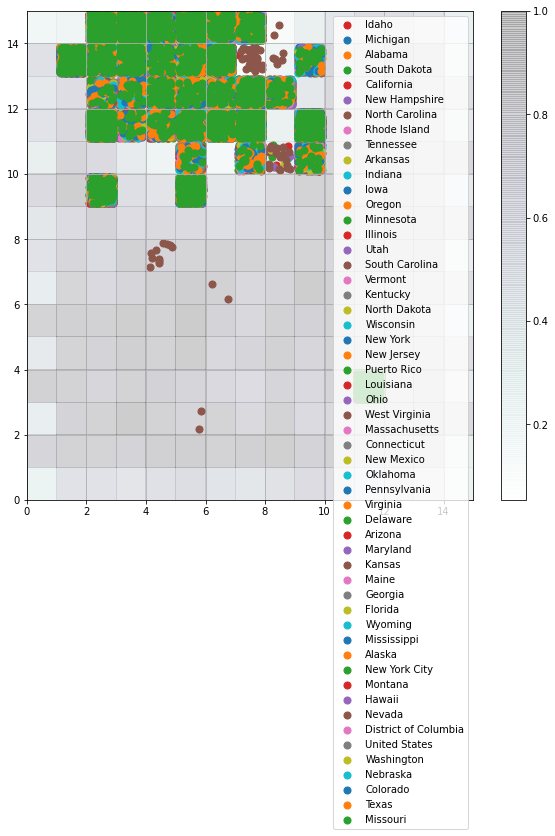

In [148]:
# not useful 
plot_distribution_map(som3, nom_data3, target_state, label_state, colors_state)

In [150]:
def grid_spec(data, label_names, n_neurons, m_neurons, target):
    import matplotlib.gridspec as gridspec

    labels_map = som.labels_map(data, [label_names[t] for t in target])

    fig = plt.figure(figsize=(9, 9))
    the_grid = gridspec.GridSpec(n_neurons, m_neurons, fig)
    for position in labels_map.keys():
        label_fracs = [labels_map[position][l] for l in label_names.values()]
        plt.subplot(the_grid[n_neurons-1-position[1],
                             position[0]], aspect=1)
        patches, texts = plt.pie(label_fracs)

    plt.legend(patches, label_names.values(), bbox_to_anchor=(3.5, 6.5), ncol=3)
    plt.savefig('/Users/cookiepoon/STA160_projects/som_state_pies.png')
    plt.show()

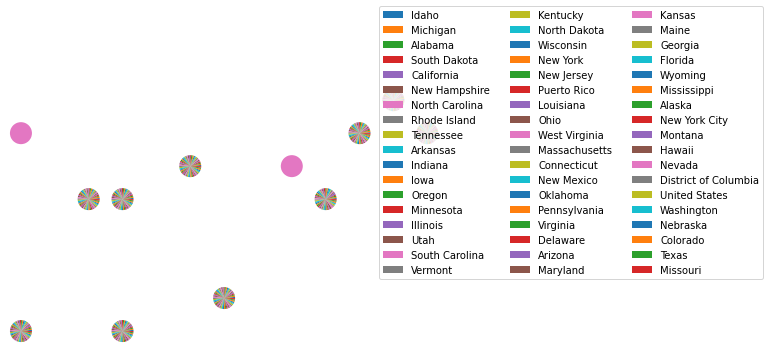

In [151]:
# not useful 
grid_spec(nom_data3, label_state, 15, 15, target_state)

### Clustering

In [152]:
df_state_min_max.head()

,COVID-19 Deaths,Number of Mentions,Age_labeled,cond_group_encode,condition_encode,ICD10_encode
0,0.000675,0.000700,0.000000,0.835733,0.04461,0.544858
1,0.003128,0.003203,0.111111,0.835733,0.04461,0.544858
2,0.008309,0.008518,0.222222,0.835733,0.04461,0.544858
3,0.024824,0.025520,0.333333,0.835733,0.04461,0.544858
4,0.063441,0.065125,0.444444,0.835733,0.04461,0.544858


In [153]:
data_cl = df_state_min_max.values

#### K-Means

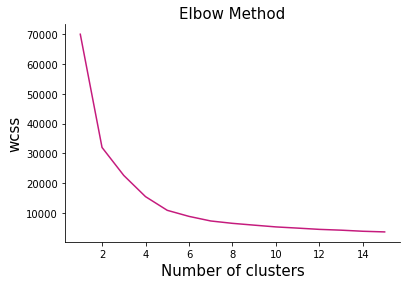

In [154]:
# determine the number of clusters
#The Elbow method looks at how the total WSS(within cluster sum of squares) varies with the number of clusters.
from sklearn.cluster import KMeans
wcss = []
for i in range(1,16):
    km = KMeans(n_clusters=i,init='k-means++', max_iter=300, n_init=10, random_state=0)
    km.fit(data_cl)
    wcss.append(km.inertia_)
plt.plot(range(1,16),wcss, c="#c51b7d")
plt.gca().spines["top"].set_visible(False)
plt.gca().spines["right"].set_visible(False)
plt.title('Elbow Method', size=15)
plt.xlabel('Number of clusters', size=15)
plt.ylabel('wcss', size=15)
plt.show() 

Based on the elbow method results, the optimal number of k is 4

In [155]:
# k-means clustering
from sklearn.cluster import KMeans

num_clusters = 4

# number of clusters
km = KMeans(n_clusters=num_clusters)
km.fit(data_cl)

labels = km.predict(data_cl)
#print(clusters)

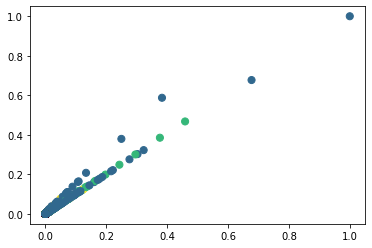

In [156]:
plt.scatter(data_cl[:, 0], data_cl[:, 1], c=labels,
            s=50, cmap='viridis')

Clusters seem to overlap, but we can create visualizations on specific data points from different segments of data from clusters. 

### Analyze data based on clusters

In [174]:
# get centroids and corresponding index in the original dataset 
def group_data_clusters(data, centroids):
    cluster_dict = {}
    for i in range(len(centroids)):
        lab = centroids[i]
        if lab not in cluster_dict: 
            cluster_dict[lab] = []
        tmp = cluster_dict[lab]
        tmp.append(data[i])
        cluster_dict[lab] = tmp 
    return cluster_dict

In [184]:
data_tmp = df_som.values

In [186]:
cluster_dict = group_data_clusters(data_tmp, labels)

In [187]:
def array_to_list(cluster_dict, i):
    cluster_data = [l.tolist() for l in cluster_dict[i]]
    return cluster_data

In [188]:
data_cl1 = array_to_list(cluster_dict, 0)
data_cl2 = array_to_list(cluster_dict, 1)
data_cl3 = array_to_list(cluster_dict, 2)
data_cl4 = array_to_list(cluster_dict, 3)

In [192]:
# COVID-19 Deaths	Number of Mentions	Age_labeled	cond_group_encode	condition_encode	ICD10_encode
cl_col_names = ['State', 'ICD10_codes', 'Age Group', 'COVID-19 Deaths',
       'Number of Mentions', 'Condition', 'Condition Group', 'state_encode',
       'cond_group_encode', 'ICD10_encode', 'Age_labeled', 'condition_encode']

In [193]:
df_cluster1 = pd.DataFrame(data_cl1, columns = cl_col_names)

In [194]:
df_cluster2 = pd.DataFrame(data_cl2, columns = cl_col_names)

In [195]:
df_cluster3 = pd.DataFrame(data_cl3, columns = cl_col_names)

In [196]:
df_cluster4 = pd.DataFrame(data_cl4, columns = cl_col_names)

#### Visualize data distributions on different clustering data

##### Disease Types Interpretation
The top 10 diseases for each cluster were the same, with the most common disease type as U071, F01, F03. The third most common categories involves more diverse types of dieases. 
Some example interpretation of the codes are following: 
- U071 means 2019-nCoV acute respiratory disease
- F01, F03: 
    - F01: Vascular dementia
    - F03: Unspecified dementia F03
- Third most common disease types (example): 
    - A00 - B99: Certain infectious and parasitic diseases
    - D00: Carcinoma in situ of oral cavity, esophagus and stomach
    - E07: Other disorders of thyroid
   

##### Death Conditions Visualization

In [199]:
def plot_top_death_conditions(df, top_n):
    f1 = sns.catplot(x="Condition", kind="count", palette="ch:.25", data=df[['Condition']], order = df.Condition.value_counts()[:top_n].index)
    f1.set_xticklabels(rotation=40)

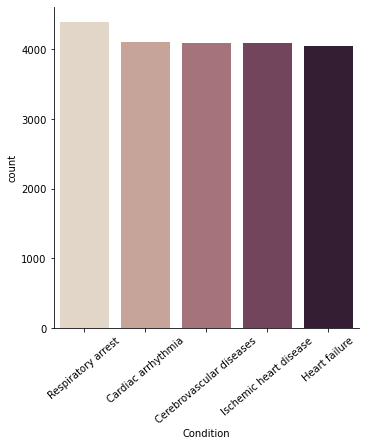

In [200]:
# top 5 death conditions for cluster 1
import seaborn as sns
plot_top_death_conditions(df_cluster1, 5)
# cluster 1 contain mostly heart related diseases as death conditions

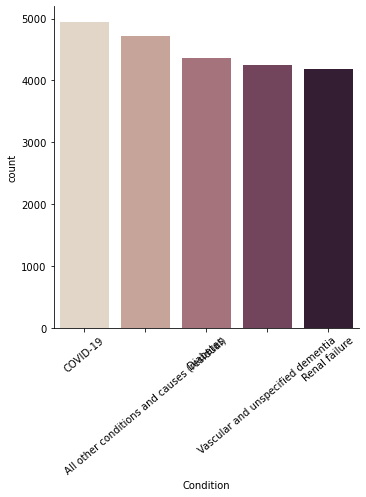

In [201]:
# top 5 death conditions for cluster 2
plot_top_death_conditions(df_cluster2, 5)
# cluster 2 contain vascular related diseases and covid-19. 

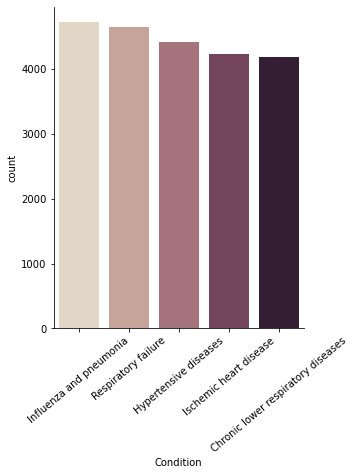

In [202]:
# cluster 3
plot_top_death_conditions(df_cluster3, 5)
# cluster 3 contain respiratory diseases as death conditions.

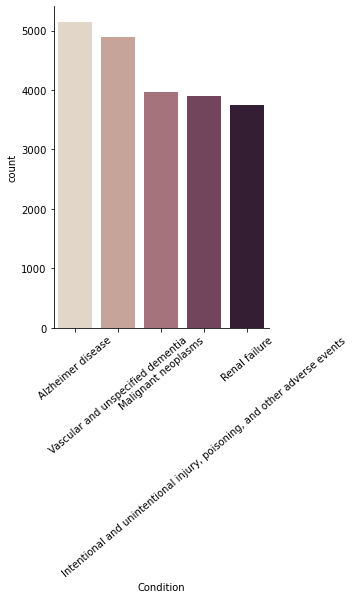

In [203]:
# cluster 4
plot_top_death_conditions(df_cluster4, 5)
# cluster 4 is similar to cluster 2, but contain mostly brain related diseases as death conditions. 

We can assign names to different clusters according to the disease types, and explore the age group in each cluster group.
- cluster1: heart related death
- cluster2: vascular death & covid-19
- cluster3: respiratory death
- cluster4: brain related death 

##### Age Group Visualizations

In [206]:
df_som.columns

Index(['State', 'ICD10_codes', 'Age Group', 'COVID-19 Deaths',
       'Number of Mentions', 'Condition', 'Condition Group', 'state_encode',
       'cond_group_encode', 'ICD10_encode', 'Age_labeled', 'condition_encode'],
      dtype='object')

In [208]:
def plot_top_age_groups(df, top_n):
    f1 = sns.catplot(x="Age Group", kind="count", palette="ch:.25", data=df[['Age Group']], order = df['Age Group'].value_counts()[:top_n].index)
    f1.set_xticklabels(rotation=40)

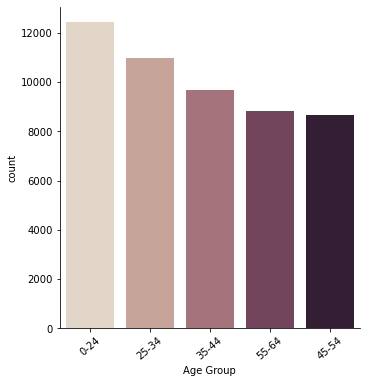

In [209]:
# heart related death cluster
plot_top_age_groups(df_cluster1, 5)
# most common age groups: 0-24, 25-34

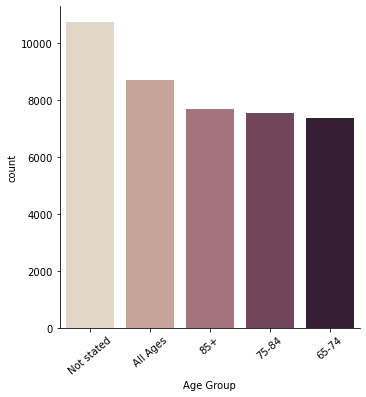

In [210]:
# vascular death & covid-19 cluster
plot_top_age_groups(df_cluster2, 5)
# Maybe it's due to the contribution of large amount of covid-19 cases, the most common group is all ages, 85+ group are also sensitive to covid-19 death and vascular diseases. 

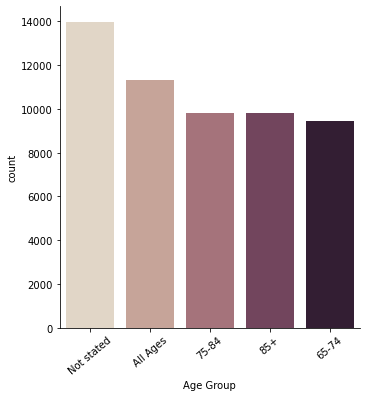

In [211]:
# respiratory death cluster 
plot_top_age_groups(df_cluster3, 5)
# respiratory death is common in all ages, next most common group is 75 ~ 84 age group

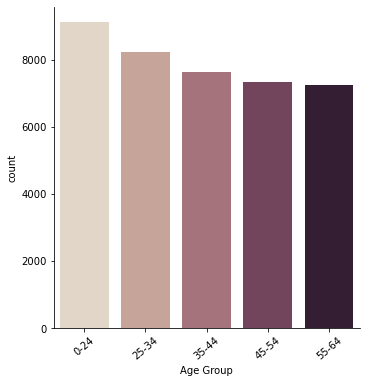

In [212]:
# brain related death
plot_top_age_groups(df_cluster4, 5)
# most common age group is 0-24, next is 25- 34

In conlusion: 
- heart related death and brain related death are most common in younger age groups such as 0-24, 25-34
- vascular death & covid-19 and respiratory death are most common in all ages, and older age group. 
- vascular death & covid-19 death has the second most common age group as 85+
- respiratory death has the second most common age group as 75-84

##### ICD_10 codes(disease types) visualization

The disease type interpretations are based on ICD10Data.com

https://www.icd10data.com/ICD10CM/Codes/

In [213]:
def plot_top_disease_types(df, top_n):
    f1 = sns.catplot(x='ICD10_codes', kind="count", palette="ch:.25", data=df[['ICD10_codes']], order = df['ICD10_codes'].value_counts()[:top_n].index)
    f1.set_xticklabels(rotation=40)

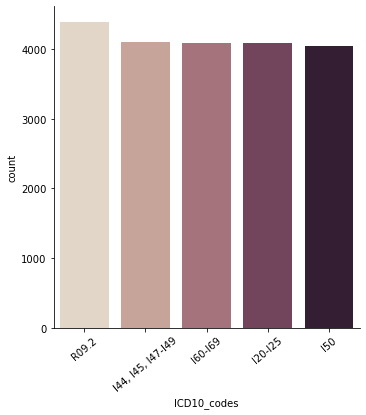

In [214]:
# heart related death cluster
plot_top_disease_types(df_cluster1, 5)
#R09-2, I44,I45, I47-I49
# cardiorespiratory failure,
# Atrioventricular and left bundle-branch block, conduction disorders, Paroxysmal tachycardia, Atrial fibrillation and flutter, Other cardiac arrhythmias

/Users/cookiepoon/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:64: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  self.fig.tight_layout(*args, **kwargs)


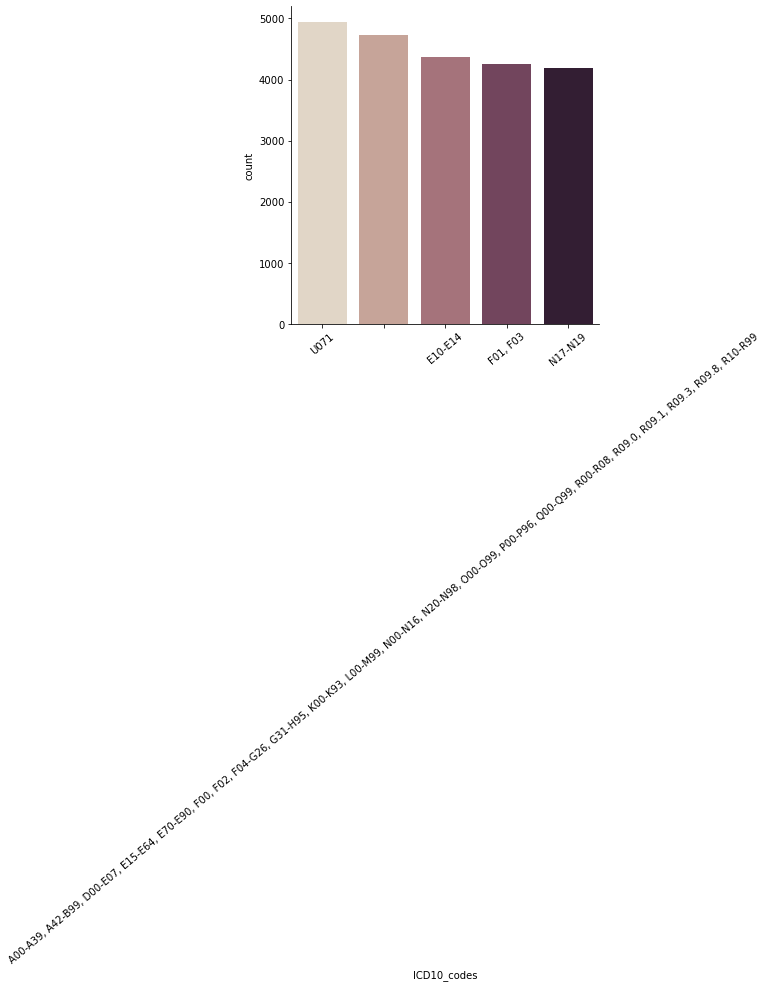

In [215]:
# vascular death & covid-19 cluster
plot_top_disease_types(df_cluster2, 5)
# U071, E10-E14
# covid-19, Type 1 diabetes mellitus 7 Other specified diabetes mellitus

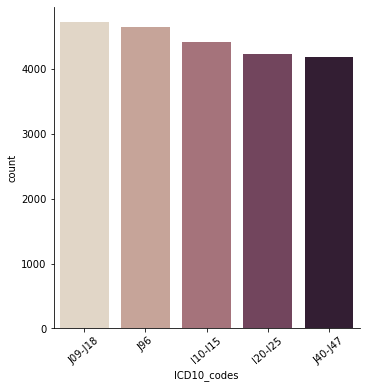

In [216]:
# respiratory death cluster 
plot_top_disease_types(df_cluster3, 5)
# J09-J18, J96
# Influenza and pneumonia, Influenza and pneumonia

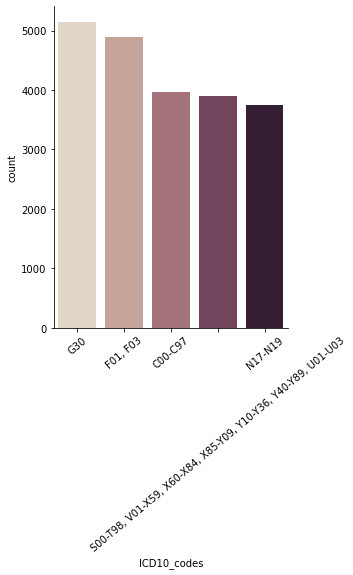

In [217]:
# brain related death
plot_top_disease_types(df_cluster4, 5)
# Alzheimer's disease, Vascular dementia, Unspecified dementia

In conclusion, the diseases types for each cluster match the death conditions: 
- In heart related death cluster, the most common disease types are cardiorespiratory failure, Atrioventricular and left bundle-branch block, conduction disorders, Paroxysmal tachycardia, Atrial fibrillation and flutter, and other cardiac arrhythmias. 
- In vascular death & covid-19 cluster, the most common disease types are covid-19, Type 1 diabetes mellitus 7 Other specified diabetes mellitus. 
- In respiratory death cluster, the most common disease types are Influenza and pneumonia, Influenza and pneumonia. 
- In brain related death cluster, the most common disease types are Alzheimer's disease, Vascular dementia, Unspecified dementia. 

##### Clusters & States visualization

In [219]:
def plot_top_states(df, top_n):
    f1 = sns.catplot(x='State', kind="count", palette="ch:.25", data=df[['State']], order = df['State'].value_counts()[:top_n].index)
    f1.set_xticklabels(rotation=40)

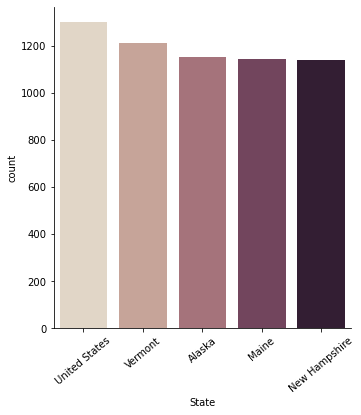

In [220]:
# heart related death cluster
plot_top_states(df_cluster1, 5)
# most common states are  Vermont, Alaska

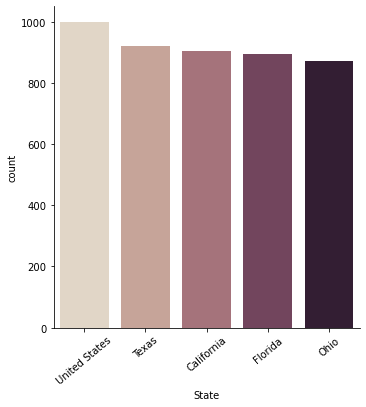

In [221]:
# vascular death & covid-19 cluster
plot_top_states(df_cluster2, 5)
# Texas, California

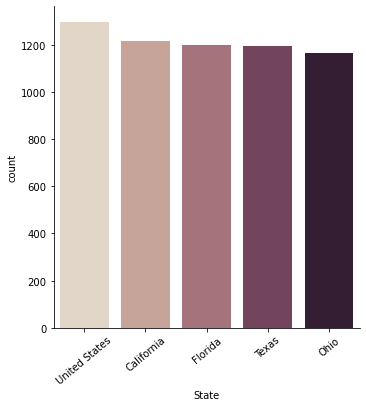

In [222]:
# respiratory death cluster 
plot_top_states(df_cluster3, 5)
# California, Florida

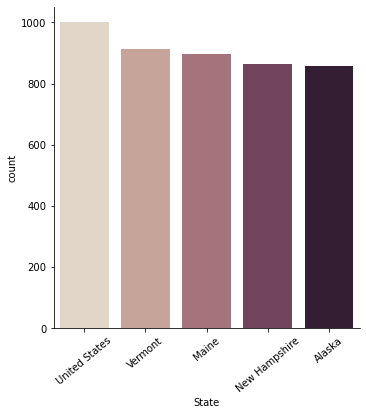

In [223]:
# brain related death
plot_top_states(df_cluster4, 5)
# Vermont, Maine

In conclusion, there appears to be a pattern between state and death condition clusters:
- for herat related death and brain related death cluster, the states are mostly in northern part of the US. 
- for vascular and respiratory related death cluster, the states are mostly in southern part of the US. 
- for heart related death cluster, most common states are Vermont, Alaska.
- for brain related death cluster, most common states are Vermont, Maine.
- for vascular death & covid-19 death cluster, most common states are California, Texas.
- for respiratory death cluster death cluster, most common states are California, Florida.